# Telco Churn Project Notebook 1

In [1]:
import numpy as np
import seaborn as sns
import scipy.stats as stats
import pandas as pd
import matplotlib.pyplot as plt
import itertools
from math import sqrt
# to turn off pink warning boxes basically for display purposes in class
# import warnings
# warnings.filterwarnings('ignore')

# import splitting and imputing functions
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

# classification algorithms
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression

# classification analysis
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# to see local file system
import os

# import our own modules
import env
import acquire as a
import prepare as p

# jupyter settings
%matplotlib inline

In [2]:
# this is a really wide df and jupyter defaults to limiting the view
# that some columns are not displayed. To work around this can use this
# command or, even better a .T to transpose

pd.set_option('display.max_columns', None)
td = a.get_telco_data()
td.head()

,customer_id,gender,senior_citizen,partner,dependents,tenure,phone_service,multiple_lines,internet_service_type_id,online_security,online_backup,device_protection,tech_support,streaming_tv,streaming_movies,contract_type_id,paperless_billing,payment_type_id,monthly_charges,total_charges,churn,payment_type_id.1,monthly_charges.1,total_charges.1,churn_month,contract_type_id.1,paperless_billing.1,gender.1,senior_citizen.1,partner.1,dependents.1,signup_date,phone_service.1,multiple_lines.1,internet_service_type_id.1,online_security.1,online_backup.1,device_protection.1,tech_support.1,streaming_tv.1,streaming_movies.1,internet_service_type_id.2,internet_service_type,contract_type_id.2,contract_type,payment_type_id.2,payment_type
0,0002-ORFBO,Female,0,Yes,Yes,9,Yes,No,1,No,Yes,No,Yes,Yes,No,2,Yes,2,65.6,593.3,No,2,65.6,593.3,NaN,2,Yes,Female,0,Yes,Yes,2021-04-21 18:07:34,Yes,No,1,No,Yes,No,Yes,Yes,No,1,DSL,2,One year,2,Mailed check
1,0003-MKNFE,Male,0,No,No,9,Yes,Yes,1,No,No,No,No,No,Yes,1,No,2,59.9,542.4,No,2,59.9,542.4,NaN,1,No,Male,0,No,No,2021-04-21 18:07:34,Yes,Yes,1,No,No,No,No,No,Yes,1,DSL,1,Month-to-month,2,Mailed check
2,0004-TLHLJ,Male,0,No,No,4,Yes,No,2,No,No,Yes,No,No,No,1,Yes,1,73.9,280.85,Yes,1,73.9,280.85,2022-01-31,1,Yes,Male,0,No,No,2021-09-21 18:07:34,Yes,No,2,No,No,Yes,No,No,No,2,Fiber optic,1,Month-to-month,1,Electronic check
3,0011-IGKFF,Male,1,Yes,No,13,Yes,No,2,No,Yes,Yes,No,Yes,Yes,1,Yes,1,98.0,1237.85,Yes,1,98.0,1237.85,2022-01-31,1,Yes,Male,1,Yes,No,2020-12-21 18:07:34,Yes,No,2,No,Yes,Yes,No,Yes,Yes,2,Fiber optic,1,Month-to-month,1,Electronic check
4,0013-EXCHZ,Female,1,Yes,No,3,Yes,No,2,No,No,No,Yes,Yes,No,1,Yes,2,83.9,267.4,Yes,2,83.9,267.4,2022-01-31,1,Yes,Female,1,Yes,No,2021-10-21 18:07:34,Yes,No,2,No,No,No,Yes,Yes,No,2,Fiber optic,1,Month-to-month,2,Mailed check


In [3]:
td.shape

(7043, 47)

In [4]:
td.T

0                    1     \
customer_id                          0002-ORFBO           0003-MKNFE   
gender                                   Female                 Male   
senior_citizen                                0                    0   
partner                                     Yes                   No   
dependents                                  Yes                   No   
tenure                                        9                    9   
phone_service                               Yes                  Yes   
multiple_lines                               No                  Yes   
internet_service_type_id                      1                    1   
online_security                              No                   No   
online_backup                               Yes                   No   
device_protection                            No                   No   
tech_support                                Yes                   No   
streaming_tv                                Yes                   No   
streaming_movies                             No                  Yes   
contract_type_id                              2                    1   
paperless_billing                           Yes                   No   
payment_type_id                               2                    2   
monthly_charges                            65.6                 59.9   
total_charges                             593.3                542.4   
churn                                        No                   No   
payment_type_id.1                             2                    2   
monthly_charges.1                          65.6                 59.9   
total_charges.1                           593.3                542.4   
churn_month                                 NaN                  NaN   
contract_type_id.1                            2                    1   
paperless_billing.1                         Yes                   No   
gender.1                                 Female                 Male   
senior_citizen.1                              0                    0   
partner.1                                   Yes                   No   
dependents.1                                Yes                   No   
signup_date                 2021-04-21 18:07:34  2021-04-21 18:07:34   
phone_service.1                             Yes                  Yes   
multiple_lines.1                             No                  Yes   
internet_service_type_id.1                    1                    1   
online_security.1                            No                   No   
online_backup.1                             Yes                   No   
device_protection.1                          No                   No   
tech_support.1                              Yes                   No   
streaming_tv.1                              Yes                   No   
streaming_movies.1                           No                  Yes   
internet_service_type_id.2                    1                    1   
internet_service_type                       DSL                  DSL   
contract_type_id.2                            2                    1   
contract_type                          One year       Month-to-month   
payment_type_id.2                             2                    2   
payment_type                       Mailed check         Mailed check   

                                           2                    3     \
customer_id                          0004-TLHLJ           0011-IGKFF   
gender                                     Male                 Male   
senior_citizen                                0                    1   
partner                                      No                  Yes   
dependents                                   No                   No   
tenure                                        4                   13   
phone_service                               Yes                  Yes   
multiple_l

In [5]:
# there are many duplicate columns all of which end in a 1 or 2
# there are no other columns that end in a number.
# I will create a list of duplicate columns with a loop 
# then I will feed that list to .drop()

dup_cols = [col for col in td.columns if col.endswith(('1', '2'))]

dup_cols

['payment_type_id.1',
 'monthly_charges.1',
 'total_charges.1',
 'contract_type_id.1',
 'paperless_billing.1',
 'gender.1',
 'senior_citizen.1',
 'partner.1',
 'dependents.1',
 'phone_service.1',
 'multiple_lines.1',
 'internet_service_type_id.1',
 'online_security.1',
 'online_backup.1',
 'device_protection.1',
 'tech_support.1',
 'streaming_tv.1',
 'streaming_movies.1',
 'internet_service_type_id.2',
 'contract_type_id.2',
 'payment_type_id.2']

In [6]:
print(f'shape before dup_col drop: {td.shape}')
td.drop(columns=dup_cols, inplace=True)
print(f'shape after dup_col drop: {td.shape}')

shape before dup_col drop: (7043, 47)
shape after dup_col drop: (7043, 26)


In [7]:
# dropped 21 duplicate columns, a step in the right direction
td.head().T

,0,1,2,3,4
customer_id,0002-ORFBO,0003-MKNFE,0004-TLHLJ,0011-IGKFF,0013-EXCHZ
gender,Female,Male,Male,Male,Female
senior_citizen,0,0,0,1,1
partner,Yes,No,No,Yes,Yes
dependents,Yes,No,No,No,No
tenure,9,9,4,13,3
phone_service,Yes,Yes,Yes,Yes,Yes
multiple_lines,No,Yes,No,No,No
internet_service_type_id,1,1,2,2,2
online_security,No,No,No,No,No


In [8]:
# checking some value_counts:
td.payment_type.value_counts()

# col_names = td.columns.tolist()
# col_names
# [col for col in col_names if td[col].value_counts() < 10]

Electronic check             2365
Mailed check                 1612
Bank transfer (automatic)    1544
Credit card (automatic)      1522
Name: payment_type, dtype: int64

In [9]:
# checking dtypes and null values
# there don't appear to be any null values
td.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7043 entries, 0 to 7042
Data columns (total 26 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   customer_id               7043 non-null   object 
 1   gender                    7043 non-null   object 
 2   senior_citizen            7043 non-null   int64  
 3   partner                   7043 non-null   object 
 4   dependents                7043 non-null   object 
 5   tenure                    7043 non-null   int64  
 6   phone_service             7043 non-null   object 
 7   multiple_lines            7043 non-null   object 
 8   internet_service_type_id  7043 non-null   int64  
 9   online_security           7043 non-null   object 
 10  online_backup             7043 non-null   object 
 11  device_protection         7043 non-null   object 
 12  tech_support              7043 non-null   object 
 13  streaming_tv              7043 non-null   object 
 14  streamin

In [10]:
# there are three values of internet_service_type_id
td.internet_service_type_id.value_counts()

2    3096
1    2421
3    1526
Name: internet_service_type_id, dtype: int64

In [11]:
td[td.internet_service_type_id == 3].head().T

,20,23,24,27,28
customer_id,0023-UYUPN,0030-FNXPP,0031-PVLZI,0040-HALCW,0042-JVWOJ
gender,Female,Female,Female,Male,Male
senior_citizen,1,0,0,0,0
partner,Yes,No,Yes,Yes,No
dependents,No,No,Yes,Yes,No
tenure,50,3,4,54,26
phone_service,Yes,Yes,Yes,Yes,Yes
multiple_lines,Yes,No,No,No,No
internet_service_type_id,3,3,3,3,3
online_security,No internet service,No internet service,No internet service,No internet service,No internet service


In [12]:
td.contract_type_id.value_counts()

1    3875
3    1695
2    1473
Name: contract_type_id, dtype: int64

In [13]:
td.payment_type_id.value_counts()

1    2365
2    1612
3    1544
4    1522
Name: payment_type_id, dtype: int64

In [14]:
td.churn.value_counts()

No     5174
Yes    1869
Name: churn, dtype: int64

In [15]:
td.churn_month.value_counts()

2022-01-31    1869
Name: churn_month, dtype: int64

In [16]:
# It would appear that there were only 11 new customers in the last month.
# Maybe we should look at tenure of one month as well because it is not clear
# exactly how tenure is calculated.

td[td.tenure == 0].shape

(11, 26)

In [17]:
td[(td.tenure == 0) | (td.tenure == 1)].shape

(624, 26)

In [18]:
td[td.churn == 'Yes'].shape

(1869, 26)

In [19]:
# Even using the more lenient parameter of zero and one months
# for tenure, there were 624 new contracts, compared with 1869
# churns. It appears Telco is bleeding out fast. Without historical
# data, we can't verify this trend, but for January 2022 it is very
# concerning

In [20]:
january_churn = td[td.churn == 'Yes'].shape[0]
january_new_cust = td[(td.tenure == 0) | (td.tenure == 1)].shape[0]

In [21]:
# drop columns contract_type_id, internet_service_type_id, 
# and payment_type_id as they are redundant and I will
# encode their more verbose counterparts prior to modeling.

td.drop(columns=['contract_type_id', 'internet_service_type_id',
                 'payment_type_id'], inplace=True)
td.shape

(7043, 23)

In [22]:
td.head().T

,0,1,2,3,4
customer_id,0002-ORFBO,0003-MKNFE,0004-TLHLJ,0011-IGKFF,0013-EXCHZ
gender,Female,Male,Male,Male,Female
senior_citizen,0,0,0,1,1
partner,Yes,No,No,Yes,Yes
dependents,Yes,No,No,No,No
tenure,9,9,4,13,3
phone_service,Yes,Yes,Yes,Yes,Yes
multiple_lines,No,Yes,No,No,No
online_security,No,No,No,No,No
online_backup,Yes,No,No,Yes,No


In [23]:
# churn month is not useful as this is data for only one month
td.drop(columns='churn_month', inplace=True)

In [24]:
# most of signup_date usefulness is already reflected in tenure
# so choosing to drop signup_date
td.drop(columns='signup_date', inplace=True)
td.shape

(7043, 21)

In [25]:
# customer_id field is irrelavent after importing to a DataFrame 
# and could be detrimental during modeling so will drop.
td.drop(columns='customer_id', inplace=True)
td.shape

(7043, 20)

In [26]:
# need to investigate why total_charges dtype is object:
td.total_charges.describe()

count     7043
unique    6531
top       20.2
freq        11
Name: total_charges, dtype: object

In [27]:
# almost 300 observations for total_charges are not decimal
td[td.total_charges.str.isdecimal() == False][['total_charges']]

,total_charges
0,593.3
1,542.4
2,280.85
3,1237.85
4,267.4
...,...
7038,633.45
7039,70.15
7040,85.5
7041,92.75


In [28]:
# pandas doesn't see any null vals
td.total_charges.isna()

0       False
1       False
2       False
3       False
4       False
        ...  
7038    False
7039    False
7040    False
7041    False
7042    False
Name: total_charges, Length: 7043, dtype: bool

In [29]:
# so checking for unique vals that may be problematic:
# aha! there seem to be 11 blanks. Maybe those are 
# white space and don't show null. Try adding a '0' to all strings
# so that pandas will see it all values as float-able

td.total_charges.value_counts()

20.2       11
           11
19.75       9
19.9        8
19.65       8
           ..
985.05      1
1396        1
435         1
3720.35     1
3707.6      1
Name: total_charges, Length: 6531, dtype: int64

In [30]:
# try to cast to float and see what happens
# didn't work, trying adding zero to all
td.total_charges = (td.total_charges + '0').astype('float')

In [31]:
td.total_charges.dtype

dtype('float64')

In [32]:
# boom. float it is.

In [33]:
# now let's go back and look at the df
td.head().T

,0,1,2,3,4
gender,Female,Male,Male,Male,Female
senior_citizen,0,0,0,1,1
partner,Yes,No,No,Yes,Yes
dependents,Yes,No,No,No,No
tenure,9,9,4,13,3
phone_service,Yes,Yes,Yes,Yes,Yes
multiple_lines,No,Yes,No,No,No
online_security,No,No,No,No,No
online_backup,Yes,No,No,Yes,No
device_protection,No,No,Yes,Yes,No


In [34]:
# okay, time for some univariate analysis
# before encoding and splitting the dataset

td.columns

Index(['gender', 'senior_citizen', 'partner', 'dependents', 'tenure',
       'phone_service', 'multiple_lines', 'online_security', 'online_backup',
       'device_protection', 'tech_support', 'streaming_tv', 'streaming_movies',
       'paperless_billing', 'monthly_charges', 'total_charges', 'churn',
       'internet_service_type', 'contract_type', 'payment_type'],
      dtype='object')

In [35]:
# Split the columns into categorical and numerical vars
# this will allow me to build loops for charts

cat_cols, num_cols = [], []
for col in td.columns:
    if td[col].dtype == 'O':
        cat_cols.append(col)
    else:
        if td[col].nunique() < 10:
            cat_cols.append(col)
        else:
            num_cols.append(col)

In [36]:
cat_cols

['gender',
 'senior_citizen',
 'partner',
 'dependents',
 'phone_service',
 'multiple_lines',
 'online_security',
 'online_backup',
 'device_protection',
 'tech_support',
 'streaming_tv',
 'streaming_movies',
 'paperless_billing',
 'churn',
 'internet_service_type',
 'contract_type',
 'payment_type']

In [37]:
num_cols

['tenure', 'monthly_charges', 'total_charges']

In [38]:
# make a list of all of the columns to explore

explore_cols = cat_cols + num_cols

Univariate analysis of feature gender:


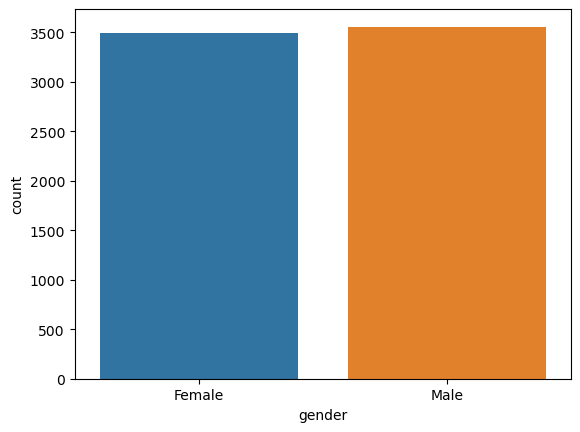

        gender    gender
Male      3555  0.504756
Female    3488  0.495244
_________________________________
_________________________________
Univariate analysis of feature senior_citizen:


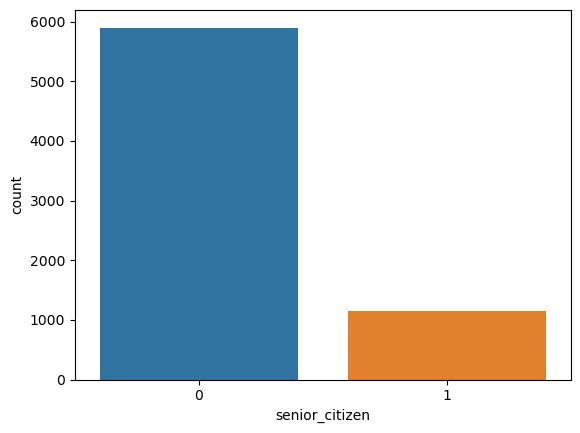

   senior_citizen  senior_citizen
0            5901        0.837853
1            1142        0.162147
_________________________________
_________________________________
Univariate analysis of feature partner:


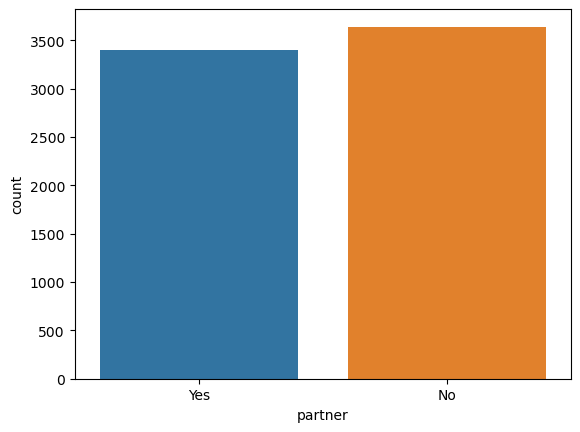

     partner   partner
No      3641  0.516967
Yes     3402  0.483033
_________________________________
_________________________________
Univariate analysis of feature dependents:


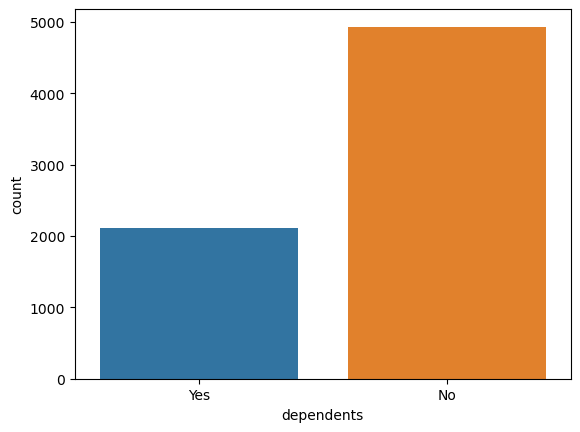

     dependents  dependents
No         4933    0.700412
Yes        2110    0.299588
_________________________________
_________________________________
Univariate analysis of feature phone_service:


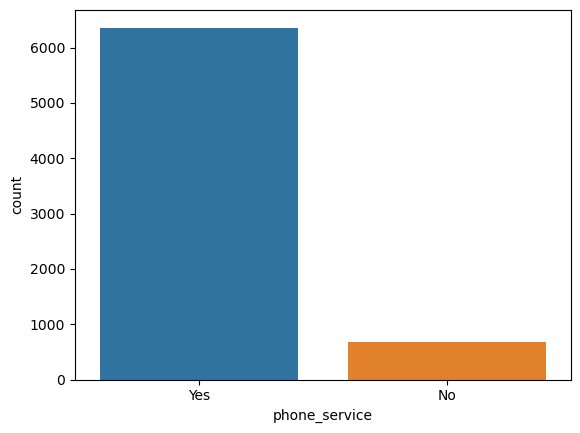

     phone_service  phone_service
Yes           6361       0.903166
No             682       0.096834
_________________________________
_________________________________
Univariate analysis of feature multiple_lines:


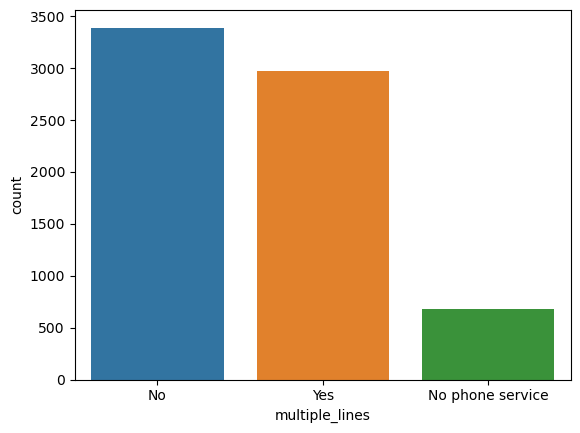

                  multiple_lines  multiple_lines
No                          3390        0.481329
Yes                         2971        0.421837
No phone service             682        0.096834
_________________________________
_________________________________
Univariate analysis of feature online_security:


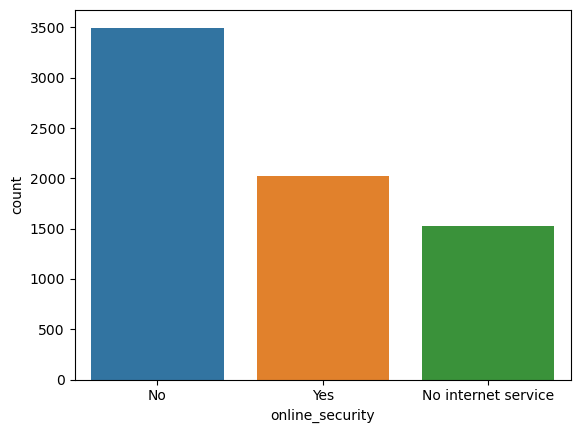

                     online_security  online_security
No                              3498         0.496663
Yes                             2019         0.286668
No internet service             1526         0.216669
_________________________________
_________________________________
Univariate analysis of feature online_backup:


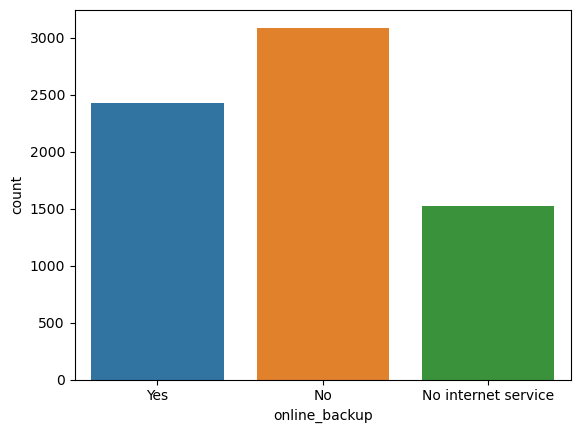

                     online_backup  online_backup
No                            3088       0.438450
Yes                           2429       0.344881
No internet service           1526       0.216669
_________________________________
_________________________________
Univariate analysis of feature device_protection:


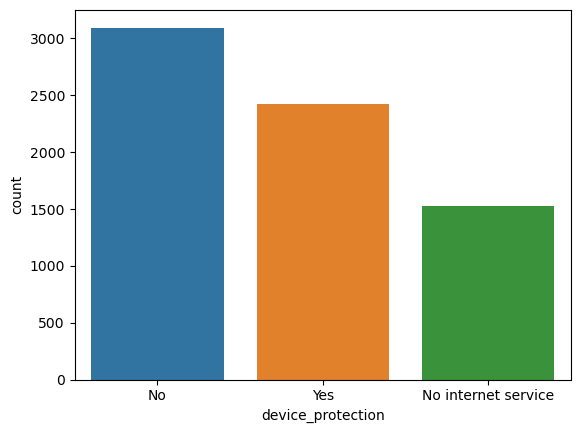

                     device_protection  device_protection
No                                3095           0.439443
Yes                               2422           0.343888
No internet service               1526           0.216669
_________________________________
_________________________________
Univariate analysis of feature tech_support:


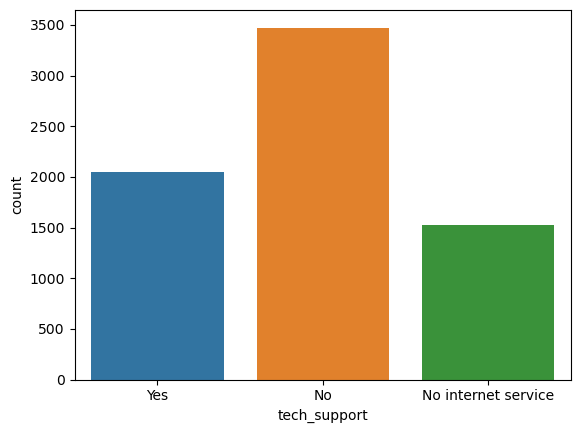

                     tech_support  tech_support
No                           3473      0.493114
Yes                          2044      0.290217
No internet service          1526      0.216669
_________________________________
_________________________________
Univariate analysis of feature streaming_tv:


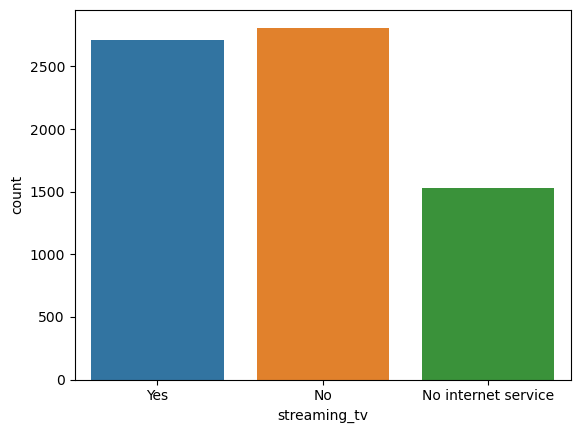

                     streaming_tv  streaming_tv
No                           2810      0.398978
Yes                          2707      0.384353
No internet service          1526      0.216669
_________________________________
_________________________________
Univariate analysis of feature streaming_movies:


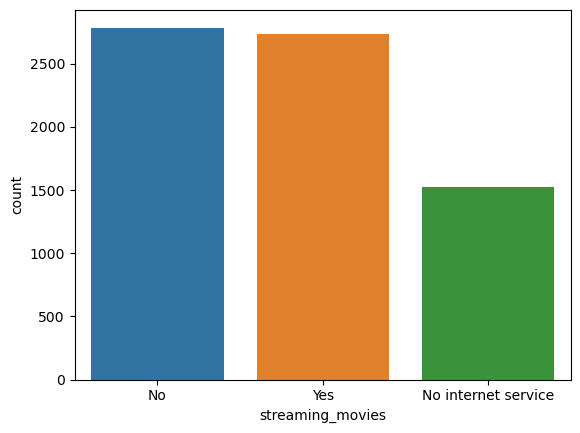

                     streaming_movies  streaming_movies
No                               2785          0.395428
Yes                              2732          0.387903
No internet service              1526          0.216669
_________________________________
_________________________________
Univariate analysis of feature paperless_billing:


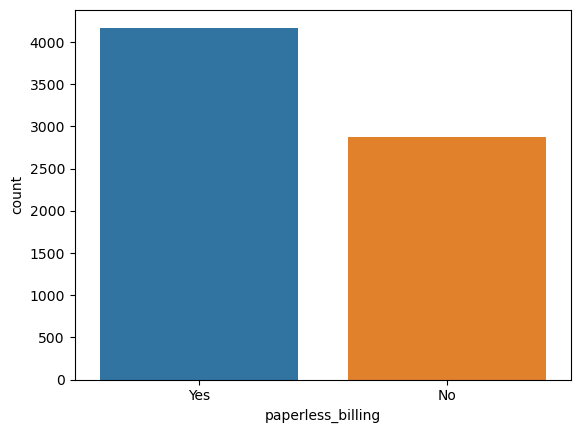

     paperless_billing  paperless_billing
Yes               4171           0.592219
No                2872           0.407781
_________________________________
_________________________________
Univariate analysis of feature churn:


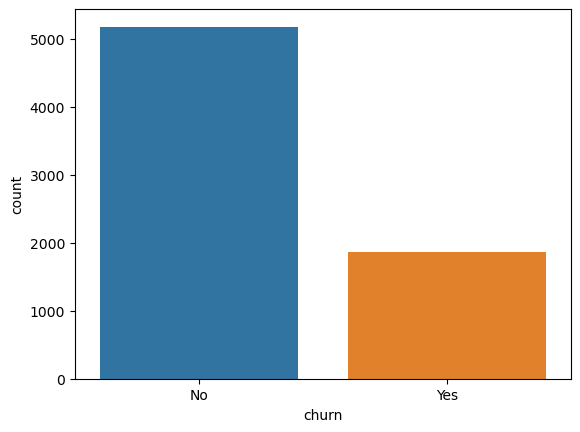

     churn    churn
No    5174  0.73463
Yes   1869  0.26537
_________________________________
_________________________________
Univariate analysis of feature internet_service_type:


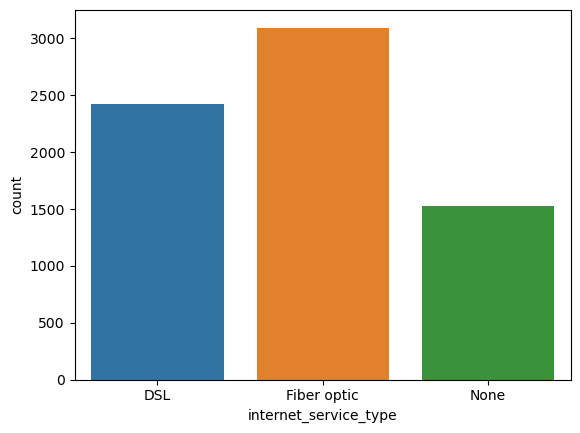

             internet_service_type  internet_service_type
Fiber optic                   3096               0.439585
DSL                           2421               0.343746
None                          1526               0.216669
_________________________________
_________________________________
Univariate analysis of feature contract_type:


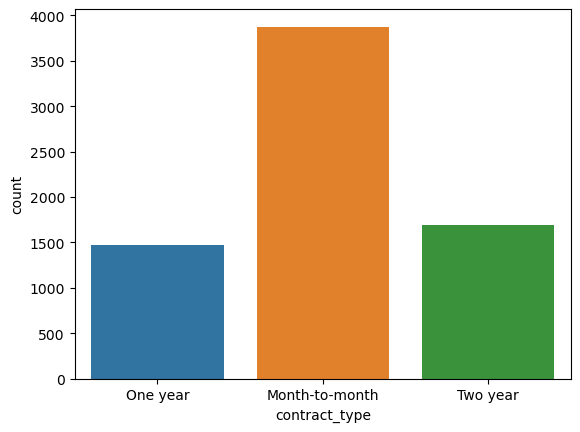

                contract_type  contract_type
Month-to-month           3875       0.550192
Two year                 1695       0.240664
One year                 1473       0.209144
_________________________________
_________________________________
Univariate analysis of feature payment_type:


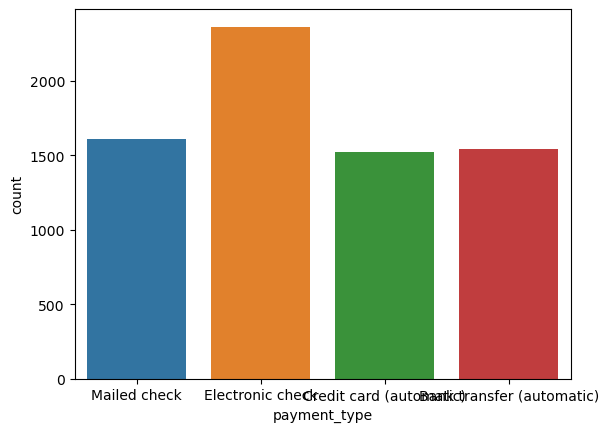

                           payment_type  payment_type
Electronic check                   2365      0.335794
Mailed check                       1612      0.228880
Bank transfer (automatic)          1544      0.219225
Credit card (automatic)            1522      0.216101
_________________________________
_________________________________
Univariate analysis of feature tenure:


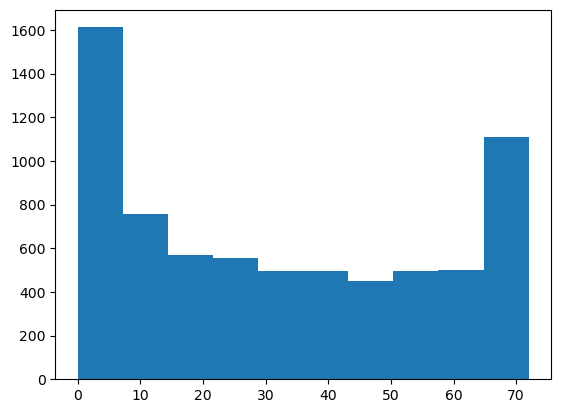

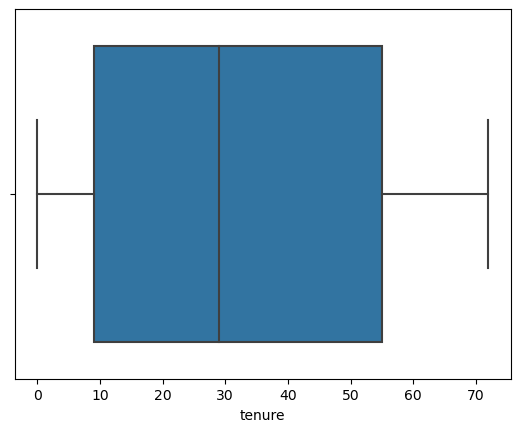

_________________________________
_________________________________
Univariate analysis of feature monthly_charges:


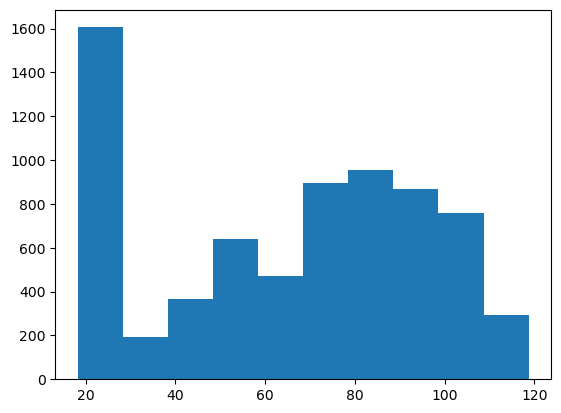

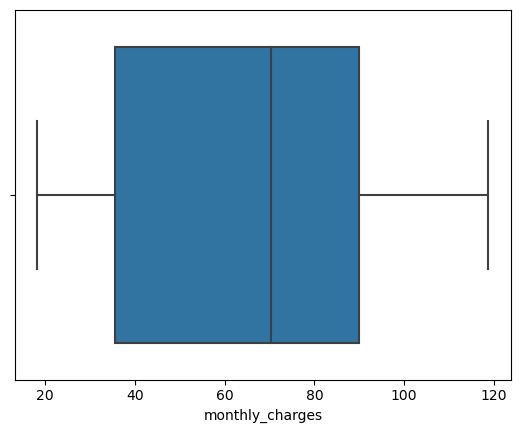

_________________________________
_________________________________
Univariate analysis of feature total_charges:


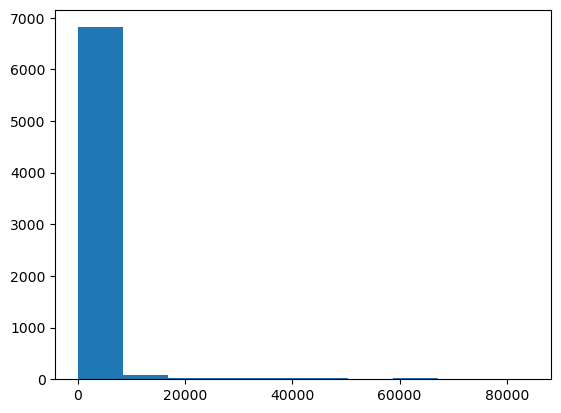

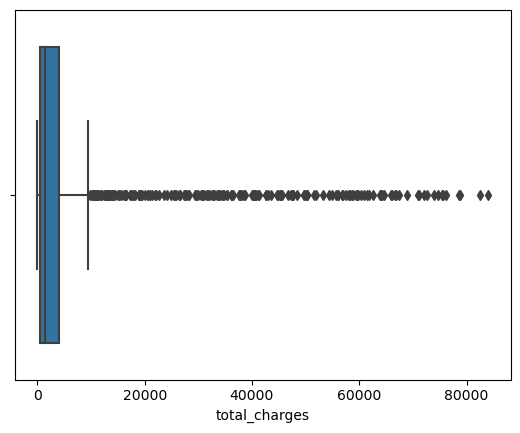

_________________________________
_________________________________


In [39]:
# now write a loop to plot them all

for col in explore_cols:
    if col in cat_cols:
        print(f'Univariate analysis of feature {col}:')
        sns.countplot(data=td, x=col)
        plt.show()
        print(pd.concat([td[col].value_counts(),
              td[col].value_counts(normalize=True)],
                       axis = 1))
    else:
        print(f'Univariate analysis of feature {col}:')
        plt.hist(td[col])
        plt.show()
        sns.boxplot(data=td, x=col)
        plt.show()
    print('_________________________________')
    print('_________________________________')

In [40]:
# Now time to encode features and split the data



In [41]:
maybe_dont_encode = []
binaries = []
categorical_cols = []
for col in td.columns:
    if td[col].dtype == 'O':
        if td[col].nunique() > 5:
            maybe_dont_encode.append(col)
        elif td[col].nunique() == 2:
            binaries.append(col)
        else:
            categorical_cols.append(col)

In [42]:
maybe_dont_encode

[]

In [43]:
categorical_cols

['multiple_lines',
 'online_security',
 'online_backup',
 'device_protection',
 'tech_support',
 'streaming_tv',
 'streaming_movies',
 'internet_service_type',
 'contract_type',
 'payment_type']

In [44]:
binaries

['gender',
 'partner',
 'dependents',
 'phone_service',
 'paperless_billing',
 'churn']